In [103]:
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
import os
import time
# torch.manual_seed(seed=42)  


In [104]:
layer_num=3
hidden_num=64
sym='symetry'

class Mynetwork(nn.Module):
    def __init__(self,input_num=1 , out_num=1,hidden_num=64):
        super().__init__()
        self.MLP=nn.Sequential(
            nn.Linear(input_num, hidden_num),
            nn.ELU(),
            nn.Linear(hidden_num,hidden_num),
            nn.ELU(),
            nn.Linear(hidden_num,hidden_num),
            nn.ELU(),
            nn.Linear(hidden_num,out_num),
        )
        pass
    def forward(self,x):
        return self.MLP(x)+self.MLP(-x)

In [105]:
def potential(x,k):
    poten=-1/2*k*x**2+1/80*k*x**4
    return poten

In [106]:
def energy(en_level,k,m,h_bar,device,dtype):
    omega=np.sqrt(k/m)
    en_list=[h_bar*omega*(1/2+i) for i in range(en_level)]
    en_list=torch.tensor(en_list,device=device,dtype=dtype)
    return en_list

In [107]:
#需要适当减小,x_M=sqrt(h_bar/(m*w)*(2n+1)),考虑要>10x_M,700sqrt(h_bar/\omega*m)
h_bar=1
m=1
b_lap:float=-h_bar**2/(2*m)

# 同时对于库伦势函数, 取e=1, 4\pi\epsilon_0=1, E_n=-1/(2n^2)
dtype=torch.float32
device=torch.device("cuda" if torch.cuda.is_available() else "cpu")
os.makedirs(f'./model_para_{sym}_{layer_num}_{hidden_num}_{dtype}', exist_ok=True)
La=-18
Lb =18
L=Lb-La  # domain length
N = 3000 # number of interior points # 对时间成本来说几乎是平方量级
h :float= L / (N+1)
grid=torch.linspace(La,Lb,N+2,dtype=dtype,device=device)
grid=grid[1:-1].unsqueeze(-1)
# 角量子数
l=0
k=4
en_num=150
epoch=5000
lr=0.01

model=Mynetwork().to(device=device,dtype=dtype)
optimizer=torch.optim.Adam(model.parameters(),lr=lr)
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer,patience=20,threshold=1e-4)
loss_fn=nn.L1Loss()
# Construct the tridiagonal matrix A
diag = -2.0 / h**2 * torch.ones(N,device=device) * b_lap
off_diag = 1.0 / h**2 * torch.ones(N - 1,device=device) * b_lap

V_diag=potential(grid,k)
A = torch.diag(diag) + torch.diag(off_diag,diagonal=1) + torch.diag(off_diag, diagonal=-1)+torch.diag(V_diag.flatten())
real_en= torch.linalg.eigvalsh(A)
print('initial real_en check:')
print(real_en[:en_num])


initial real_en check:
tensor([-1.8599e+01, -1.8599e+01, -1.5849e+01, -1.5849e+01, -1.3185e+01,
        -1.3185e+01, -1.0615e+01, -1.0614e+01, -8.1510e+00, -8.1503e+00,
        -5.8110e+00, -5.8087e+00, -3.6194e+00, -3.6192e+00, -1.6543e+00,
        -1.6096e+00, -1.4773e-01,  2.4586e-01,  1.2613e+00,  2.1536e+00,
         3.1907e+00,  4.2759e+00,  5.4197e+00,  6.6125e+00,  7.8508e+00,
         9.1315e+00,  1.0452e+01,  1.1810e+01,  1.3203e+01,  1.4631e+01,
         1.6092e+01,  1.7584e+01,  1.9107e+01,  2.0660e+01,  2.2241e+01,
         2.3851e+01,  2.5488e+01,  2.7151e+01,  2.8840e+01,  3.0554e+01,
         3.2293e+01,  3.4055e+01,  3.5842e+01,  3.7651e+01,  3.9483e+01,
         4.1338e+01,  4.3214e+01,  4.5111e+01,  4.7029e+01,  4.8968e+01,
         5.0927e+01,  5.2907e+01,  5.4905e+01,  5.6924e+01,  5.8961e+01,
         6.1017e+01,  6.3091e+01,  6.5184e+01,  6.7294e+01,  6.9422e+01,
         7.1567e+01,  7.3730e+01,  7.5910e+01,  7.8106e+01,  8.0319e+01,
         8.2549e+01,  8.4794

In [109]:

loss_list=[]
init_time=time.time()
for i in range(epoch):
    optimizer.zero_grad()
    V_diag=model(grid)
    A = torch.diag(diag) + torch.diag(off_diag,diagonal=1) + torch.diag(off_diag, diagonal=-1)+torch.diag(V_diag.flatten())
    eigenvalues= torch.linalg.eigvalsh(A)
    '''output=NN(input)
    diag=torch.diag(output.flatten())'''
    
    print('\nepoch:',i)
    print(eigenvalues[:en_num])
    print(real_en[:en_num])
    
    output=eigenvalues[:en_num]
    loss=loss_fn(output,real_en[:en_num])
    loss.backward()
    optimizer.step()
    
    loss_list.append(loss.item())
    if i%10==0:
        print(f'epoch:{i},loss:{loss},time:{time.time()-init_time},lr:{optimizer.param_groups[0]["lr"]}')
    if (i+1)%100==0:torch.save(model.state_dict(),f'./model_para_{sym}_{layer_num}_{hidden_num}_{dtype}/model_para_use_eigvalues_{en_num}_La{La}_Lb{Lb}_N{N}.pth')
    scheduler.step(loss)
    if optimizer.param_groups[0]["lr"] <= 1.1e-8:break
print('terminal epoch: ',i+1)
torch.save(model.state_dict(),f'./model_para_{sym}_{layer_num}_{hidden_num}_{dtype}/model_para_use_eigvalues_{en_num}_La{La}_Lb{Lb}_N{N}.pth')



epoch: 0
tensor([-1.8249e-01, -1.7894e-01, -9.3045e-02, -8.9675e-02,  2.2871e-02,
         2.3607e-02,  1.4702e-01,  1.4966e-01,  2.7717e-01,  2.9497e-01,
         4.1165e-01,  4.6797e-01,  5.7497e-01,  6.6344e-01,  7.7900e-01,
         8.9058e-01,  1.0175e+00,  1.1488e+00,  1.2897e+00,  1.4360e+00,
         1.5913e+00,  1.7552e+00,  1.9268e+00,  2.1037e+00,  2.2891e+00,
         2.4856e+00,  2.6879e+00,  2.8991e+00,  3.1107e+00,  3.3363e+00,
         3.5674e+00,  3.8094e+00,  4.0555e+00,  4.3112e+00,  4.5734e+00,
         4.8442e+00,  5.1213e+00,  5.4065e+00,  5.7001e+00,  6.0004e+00,
         6.3089e+00,  6.6250e+00,  6.9475e+00,  7.2799e+00,  7.6181e+00,
         7.9629e+00,  8.3188e+00,  8.6807e+00,  9.0481e+00,  9.4260e+00,
         9.8103e+00,  1.0202e+01,  1.0602e+01,  1.1009e+01,  1.1424e+01,
         1.1846e+01,  1.2276e+01,  1.2713e+01,  1.3159e+01,  1.3612e+01,
         1.4072e+01,  1.4540e+01,  1.5016e+01,  1.5499e+01,  1.5989e+01,
         1.6488e+01,  1.6994e+01,  1.7507

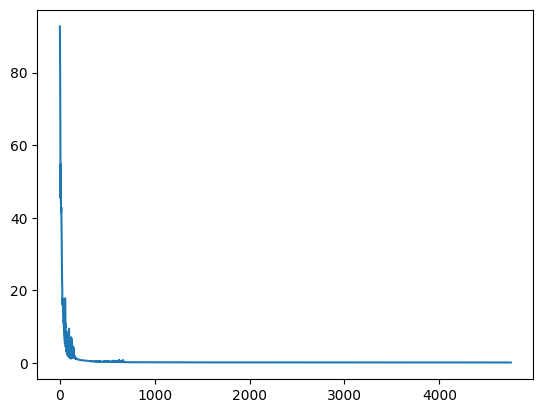

In [110]:
plt.plot(loss_list)
plt.show()

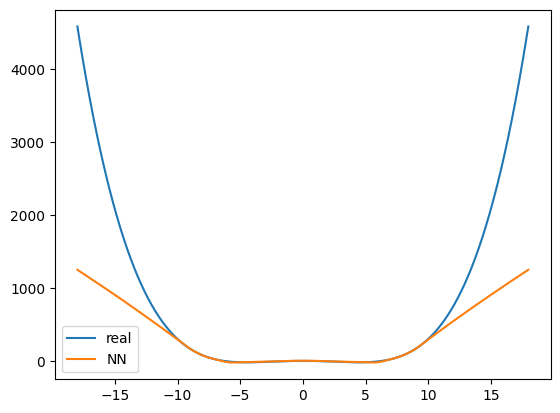

In [111]:

V_NN=model(grid)

os.makedirs(f'./V_NN_value_{sym}_{layer_num}_{hidden_num}_{dtype}', exist_ok=True)
torch.save(V_NN,f'./V_NN_value_{sym}_{layer_num}_{hidden_num}_{dtype}/V_NN_use_eigvalues_{en_num}_La{La}_Lb{Lb}_N{N}.pth')

V_NN=V_NN.cpu().detach().numpy()
real_poten=potential(grid.cpu().detach().numpy(),k)
plt.plot(grid.cpu().detach().numpy(),real_poten,label='real')
plt.plot(grid.cpu().detach().numpy(),V_NN,label='NN')
plt.legend()
plt.show()

In [112]:
error=V_NN-real_poten
mean_error=np.mean(np.abs(error))
max_error=np.max(np.abs(error))
print('mean_error:',mean_error)
print('max_error:',max_error)

mean_error: 467.95697
max_error: 3337.4106
